<a href="https://colab.research.google.com/github/SurrajKumar2000/Lung-and-Colon-Cancer-prediction-using-CNN/blob/main/M1_MANUAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MANUAL NET ARCHITECTURE

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import os
import glob
import numpy as np

from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.models import Sequential
from PIL import Image

from tensorflow.keras.layers import Convolution2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Activation

from keras.callbacks import ModelCheckpoint
import matplotlib.pyplot as plt

In [ ]:
colon_aca = 'DATASET/TRAIN/colon_aca'
colon_bnt = 'DATASET/TRAIN/colon_bnt'
lung_aca = 'DATASET/TRAIN/lung_aca'
lung_bnt = 'DATASET/TRAIN/lung_bnt'
lung_scc = 'DATASET/TRAIN/lung_scc'

In [ ]:
def plot_images(item_dir, n=6):
    all_item_dir = os.listdir(item_dir)
    item_files = [os.path.join(item_dir, file) for file in all_item_dir][:n]

    plt.figure(figsize=(80, 40))
    for idx, img_path in enumerate(item_files):
        plt.subplot(3, n, idx+1)
        img = plt.imread(img_path)
        plt.imshow(img, cmap='gray')
        plt.axis('off')

    plt.tight_layout()

def image_details_print(data,path):
    print('======== Images in: ', path)
    for key,values in data.items():
        print(key,':\t', values)


def images_details(path):
    files=[f for f in glob.glob(path + "**/*.*", recursive=True)]
    data={}
    data['Images_count']=len(files)
    data['Min_width']=10**100
    data['Max_width']=0
    data['Min_height']=10**100
    data['Max_height']=0

    for f in files:
        img=Image.open(f)
        width,height=img.size
        data['Min_width']=min(width,data['Min_width'])
        data['Max_width']=max(width, data['Max_width'])
        data['Min_height']=min(height, data['Min_height'])
        data['Max_height']=max(height, data['Max_height'])

    image_details_print(data,path)


TRAINING DATA FOR colon_aca:

======== Images in:  DATASET/TRAIN/colon_aca
Images_count :	 400
Min_width :	 512
Max_width :	 512
Min_height :	 512
Max_height :	 512



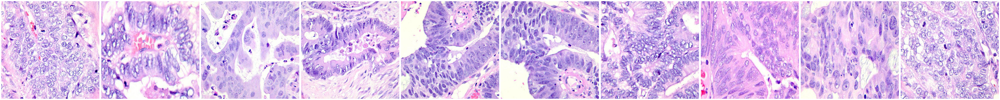

In [ ]:
print("")
print("TRAINING DATA FOR colon_aca:")
print("")
images_details(colon_aca)
print("")
plot_images(colon_aca, 10)


TRAINING DATA FOR colon_bnt:

======== Images in:  DATASET/TRAIN/colon_bnt
Images_count :	 400
Min_width :	 512
Max_width :	 512
Min_height :	 512
Max_height :	 512



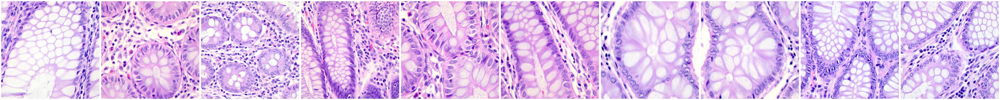

In [ ]:
print("")
print("TRAINING DATA FOR colon_bnt:")
print("")
images_details(colon_bnt)
print("")
plot_images(colon_bnt, 10)


TRAINING DATA FOR lung_aca:

======== Images in:  DATASET/TRAIN/lung_aca
Images_count :	 400
Min_width :	 512
Max_width :	 512
Min_height :	 512
Max_height :	 512



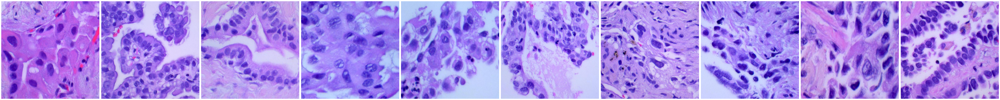

In [ ]:
print("")
print("TRAINING DATA FOR lung_aca:")
print("")
images_details(lung_aca)
print("")
plot_images(lung_aca, 10)


TRAINING DATA FOR lung_bnt:

======== Images in:  DATASET/TRAIN/lung_bnt
Images_count :	 400
Min_width :	 512
Max_width :	 512
Min_height :	 512
Max_height :	 512



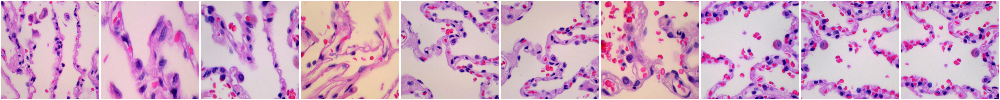

In [ ]:
print("")
print("TRAINING DATA FOR lung_bnt:")
print("")
images_details(lung_bnt)
print("")
plot_images(lung_bnt, 10)

In [ ]:
train_datagen=ImageDataGenerator(rescale=1./255,shear_range=0.2,zoom_range=0.2,horizontal_flip=True)
training_set=train_datagen.flow_from_directory('DATASET/TRAIN',target_size=(224,224),batch_size=32,class_mode='categorical')

Found 2000 images belonging to 5 classes.


In [ ]:
test_datagen=ImageDataGenerator(rescale=1./255)
test_set=test_datagen.flow_from_directory('DATASET/TEST',target_size=(224,224),batch_size=32,class_mode='categorical')

Found 2000 images belonging to 5 classes.


In [ ]:
Classifier=Sequential()
Classifier.add(Convolution2D(32,(3,3),input_shape=(224,224,3),activation='relu'))
Classifier.add(MaxPooling2D(pool_size=(2,2)))
Classifier.add(Flatten())
Classifier.add(Dense(38, activation='relu'))
Classifier.add(Dense(5, activation='softmax'))
Classifier.compile(optimizer='rmsprop',loss='categorical_crossentropy',metrics=['accuracy'])

In [ ]:
model_path = "MANUAL.h5"

callbacks = [
    ModelCheckpoint(model_path, monitor='accuracy', verbose=1, save_best_only=True)
]

In [ ]:
epochs = 10
batch_size = 512

In [ ]:
#### Fitting the model
history = Classifier.fit(
           training_set, steps_per_epoch=training_set.samples // batch_size,
           epochs=epochs,
           validation_data=test_set,validation_steps=test_set.samples // batch_size,
           callbacks=callbacks)

Epoch 1/10
3/3 [==============================] - ETA: 0s - loss: 93.0679 - accuracy: 0.1667
Epoch 1: accuracy improved from -inf to 0.16667, saving model to MANUAL.h5
3/3 [==============================] - 6s 2s/step - loss: 93.0679 - accuracy: 0.1667 - val_loss: 28.4518 - val_accuracy: 0.1875
Epoch 2/10
3/3 [==============================] - ETA: 0s - loss: 24.5988 - accuracy: 0.2812
Epoch 2: accuracy improved from 0.16667 to 0.28125, saving model to MANUAL.h5
3/3 [==============================] - 5s 2s/step - loss: 24.5988 - accuracy: 0.2812 - val_loss: 6.4289 - val_accuracy: 0.2083
Epoch 3/10
3/3 [==============================] - ETA: 0s - loss: 5.5331 - accuracy: 0.2708
Epoch 3: accuracy did not improve from 0.28125
3/3 [==============================] - 4s 1s/step - loss: 5.5331 - accuracy: 0.2708 - val_loss: 1.6090 - val_accuracy: 0.1979
Epoch 4/10
3/3 [==============================] - ETA: 0s - loss: 1.6039 - accuracy: 0.1979
Epoch 4: accuracy did not improve from 0.28125
3/

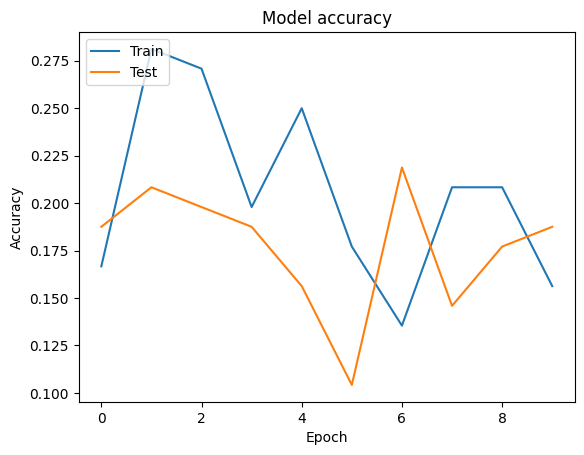

In [ ]:
import matplotlib.pyplot as plt

def graph():
    #Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

graph()

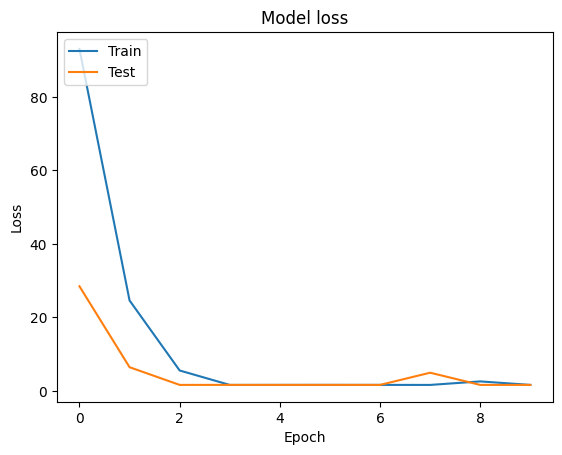

In [ ]:
import matplotlib.pyplot as plt

def graph():
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
graph()